# Sommaire :

<a href="#A1">**Partie 1 : Présentation de la base**</a>

<a href="#A2">**Partie 2 : Nettoyage**</a>
 - <a href="#C3">2-1 : Suppression des colonnes vides</a>
 - <a href="#C4">2-2 : Suppression des lignes en doublons</a>
 - <a href="#C5">2-3 : Réduction de la base aux bâtiments non destinés à l’habitation</a>
 - <a href="#C6">2-4 : Vérification des types</a>
 - <a href="#C7">2-5 : Suppression des outliers</a>
 - <a href="#C71">2-6 : Nettoyage des étiquettes</a>
    
<a href="#A3">**Partie 3 : Exploration**</a>
 - <a href="#C8">3-1 : Analyse Univariée</a>
 - <a href="#C9">3-2 : Analyse Bivariée</a>
 - <a href="#C10">3-3 : Feature engineering</a>

# <a name="A1">Partie 1 : Présentation de la base</a>

In [1]:
#Général
import numpy as np
import pandas as pd
import os
import ast
import datetime
import time

#Visualisation
import seaborn as sns
from matplotlib import pyplot as plt
import missingno as msno
import folium
import folium.plugins
from matplotlib import pyplot as plt
import plotly.graph_objs as go
import missingno as msno

#Encoding
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import make_column_transformer

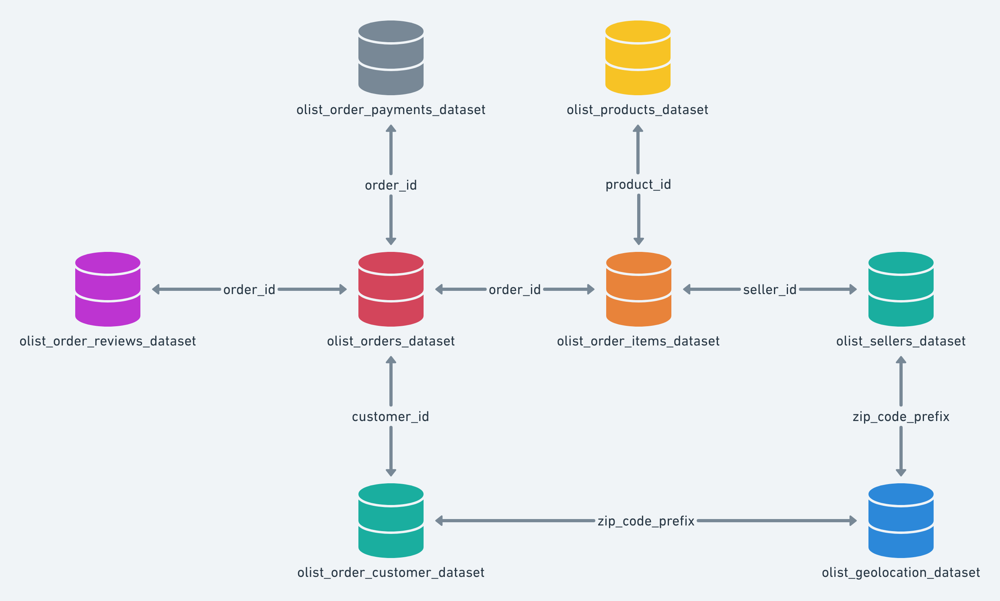

In [2]:
c=pd.read_csv('olist_customers_dataset.csv')
g=pd.read_csv('olist_geolocation_dataset.csv')
o=pd.read_csv('olist_orders_dataset.csv')
oi=pd.read_csv('olist_order_items_dataset.csv')
op=pd.read_csv('olist_order_payments_dataset.csv')
ore=pd.read_csv('olist_order_reviews_dataset.csv')
p=pd.read_csv('olist_products_dataset.csv')
s=pd.read_csv('olist_sellers_dataset.csv')
pc=pd.read_csv('product_category_name_translation.csv')

In [3]:
c.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   customer_id               99441 non-null  object
 1   customer_unique_id        99441 non-null  object
 2   customer_zip_code_prefix  99441 non-null  int64 
 3   customer_city             99441 non-null  object
 4   customer_state            99441 non-null  object
dtypes: int64(1), object(4)
memory usage: 3.8+ MB


In [4]:
g.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000163 entries, 0 to 1000162
Data columns (total 5 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   geolocation_zip_code_prefix  1000163 non-null  int64  
 1   geolocation_lat              1000163 non-null  float64
 2   geolocation_lng              1000163 non-null  float64
 3   geolocation_city             1000163 non-null  object 
 4   geolocation_state            1000163 non-null  object 
dtypes: float64(2), int64(1), object(2)
memory usage: 38.2+ MB


In [5]:
o.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   order_id                       99441 non-null  object
 1   customer_id                    99441 non-null  object
 2   order_status                   99441 non-null  object
 3   order_purchase_timestamp       99441 non-null  object
 4   order_approved_at              99281 non-null  object
 5   order_delivered_carrier_date   97658 non-null  object
 6   order_delivered_customer_date  96476 non-null  object
 7   order_estimated_delivery_date  99441 non-null  object
dtypes: object(8)
memory usage: 6.1+ MB


In [6]:
o['order_purchase_timestamp'].sort_values(ascending=False)

60938    2018-10-17 17:30:18
68373    2018-10-16 20:16:02
31891    2018-10-03 18:55:29
88500    2018-10-01 15:30:09
50387    2018-09-29 09:13:03
                ...         
83078    2016-10-02 22:07:52
30710    2016-09-15 12:16:38
10071    2016-09-13 15:24:19
4396     2016-09-05 00:15:34
4541     2016-09-04 21:15:19
Name: order_purchase_timestamp, Length: 99441, dtype: object

In [7]:
oi.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112650 entries, 0 to 112649
Data columns (total 7 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   order_id             112650 non-null  object 
 1   order_item_id        112650 non-null  int64  
 2   product_id           112650 non-null  object 
 3   seller_id            112650 non-null  object 
 4   shipping_limit_date  112650 non-null  object 
 5   price                112650 non-null  float64
 6   freight_value        112650 non-null  float64
dtypes: float64(2), int64(1), object(4)
memory usage: 6.0+ MB


In [8]:
op.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103886 entries, 0 to 103885
Data columns (total 5 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   order_id              103886 non-null  object 
 1   payment_sequential    103886 non-null  int64  
 2   payment_type          103886 non-null  object 
 3   payment_installments  103886 non-null  int64  
 4   payment_value         103886 non-null  float64
dtypes: float64(1), int64(2), object(2)
memory usage: 4.0+ MB


In [9]:
ore.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99224 entries, 0 to 99223
Data columns (total 7 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   review_id                99224 non-null  object
 1   order_id                 99224 non-null  object
 2   review_score             99224 non-null  int64 
 3   review_comment_title     11568 non-null  object
 4   review_comment_message   40977 non-null  object
 5   review_creation_date     99224 non-null  object
 6   review_answer_timestamp  99224 non-null  object
dtypes: int64(1), object(6)
memory usage: 5.3+ MB


In [10]:
p.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32951 entries, 0 to 32950
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   product_id                  32951 non-null  object 
 1   product_category_name       32341 non-null  object 
 2   product_name_lenght         32341 non-null  float64
 3   product_description_lenght  32341 non-null  float64
 4   product_photos_qty          32341 non-null  float64
 5   product_weight_g            32949 non-null  float64
 6   product_length_cm           32949 non-null  float64
 7   product_height_cm           32949 non-null  float64
 8   product_width_cm            32949 non-null  float64
dtypes: float64(7), object(2)
memory usage: 2.3+ MB


In [11]:
s.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3095 entries, 0 to 3094
Data columns (total 4 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   seller_id               3095 non-null   object
 1   seller_zip_code_prefix  3095 non-null   int64 
 2   seller_city             3095 non-null   object
 3   seller_state            3095 non-null   object
dtypes: int64(1), object(3)
memory usage: 96.8+ KB


In [12]:
pc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 71 entries, 0 to 70
Data columns (total 2 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   product_category_name          71 non-null     object
 1   product_category_name_english  71 non-null     object
dtypes: object(2)
memory usage: 1.2+ KB


In [13]:
# on fusionne les datasets
ds=[ore,o,c,op,oi,p,s,pc]
ky=['order_id','customer_id','order_id','order_id','product_id','seller_id','product_category_name']
df=ore
for i in range(len(ds)-1):
    df=df.merge(ds[i+1],on=ky[i],how='outer')

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 119143 entries, 0 to 119142
Data columns (total 40 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   review_id                      118146 non-null  object 
 1   order_id                       119143 non-null  object 
 2   review_score                   118146 non-null  float64
 3   review_comment_title           13989 non-null   object 
 4   review_comment_message         50245 non-null   object 
 5   review_creation_date           118146 non-null  object 
 6   review_answer_timestamp        118146 non-null  object 
 7   customer_id                    119143 non-null  object 
 8   order_status                   119143 non-null  object 
 9   order_purchase_timestamp       119143 non-null  object 
 10  order_approved_at              118966 non-null  object 
 11  order_delivered_carrier_date   117057 non-null  object 
 12  order_delivered_customer_date 

# <a name="A2">**Partie 2 : Nettoyage**</a>

## <a name="C3">2-1 : Suppression des colonnes vides</a>

In [15]:
df21=df.dropna(axis=1,how='all')

## <a name="C4">2-2 : Suppression des lignes en doublons</a>

In [16]:
df21.duplicated().sum()

0

## <a name="C5">2-3 : Réduction de la base aux colonnes utiles et commandes finalisées</a>

In [17]:
#On supprime les colonnes inutiles
df23=df21.drop(columns=['order_approved_at', 
                        'order_delivered_carrier_date',
                        'order_estimated_delivery_date',
                        'product_category_name', 
                        'product_name_lenght',
                        'product_description_lenght', 
                        'product_photos_qty', 
                        'product_weight_g',       
                        'product_length_cm', 
                        'product_height_cm', 
                        'product_width_cm',       
])

In [18]:
#On ne conserve que les lignes  de 'order_status' 'delivered' et 'canceled'
df23=df23.loc[(df23['order_status']==('delivered'))| (df23['order_status']==('canceled')),:]

## <a name="#C6">2-4 : Vérification des types</a>

In [19]:
df24=df23.copy()
df24.dtypes

review_id                         object
order_id                          object
review_score                     float64
review_comment_title              object
review_comment_message            object
review_creation_date              object
review_answer_timestamp           object
customer_id                       object
order_status                      object
order_purchase_timestamp          object
order_delivered_customer_date     object
customer_unique_id                object
customer_zip_code_prefix           int64
customer_city                     object
customer_state                    object
payment_sequential               float64
payment_type                      object
payment_installments             float64
payment_value                    float64
order_item_id                    float64
product_id                        object
seller_id                         object
shipping_limit_date               object
price                            float64
freight_value   

In [20]:
df24['customer_zip_code_prefix']=df24['customer_zip_code_prefix'].astype('object')
df24['seller_zip_code_prefix']=df24['seller_zip_code_prefix'].astype('object')
df24['review_score']=df24['review_score'].astype('Int64')
df24['payment_sequential']=df24['payment_sequential'].astype('Int64')
df24['payment_installments']=df24['payment_installments'].astype('Int64')
df24['order_item_id']=df24['order_item_id'].astype('Int64')
df24['order_purchase_timestamp']=df24['order_purchase_timestamp'].astype('datetime64[ns]')
df24['order_delivered_customer_date']=df24['order_delivered_customer_date'].astype('datetime64[ns]')

## <a name="C7">2-5 : Suppression des outliers</a>

In [21]:
df25=df24.copy()

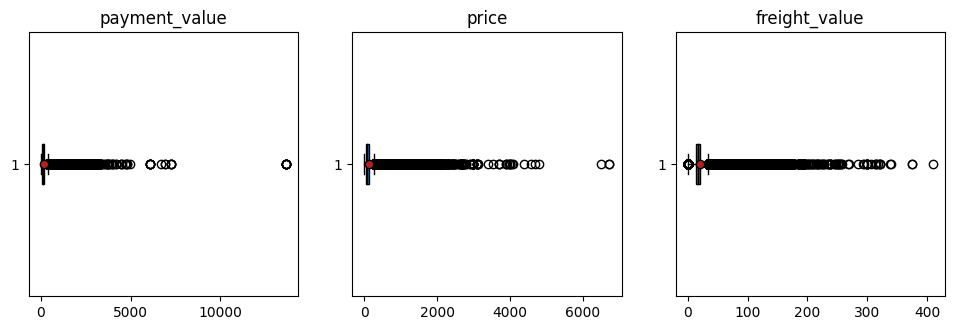

In [22]:
#AVANT suppression des outliers
data_X=df25.select_dtypes(include=['float64'])

fig = plt.figure(figsize=(16, 24))

medianprops = {'color':"black"}
meanprops = {'marker':'o', 'markeredgecolor':'black',
            'markerfacecolor':'firebrick'}
liste=[]
titres=[]
    
for feat_idx in range(0,data_X.columns.size):
    ax = fig.add_subplot(6,4, (feat_idx+1))

    data=data_X.loc[(data_X.iloc[:,feat_idx]==data_X.iloc[:,feat_idx]),:]
    data=data.iloc[:,feat_idx]
    liste.append(data)
    titres.append(feat_idx)

    h=plt.boxplot(data, showfliers=True, medianprops=medianprops, 
                vert=False, patch_artist=True, showmeans=True, meanprops=meanprops)
    plt.title(data_X.columns[feat_idx])

In [23]:
def remove_outlier_IQR(df):
    Q1=df.quantile(0.25)
    Q3=df.quantile(0.75)
    IQR=Q3-Q1
    df_final=df[~((df<(Q1-1.5*IQR)) | (df>(Q3+1.5*IQR)))]
    return df_final

In [24]:
#Suppression des outliers
for i in df25.select_dtypes(include='float64').columns :
    df25[i]=remove_outlier_IQR(df25[i])

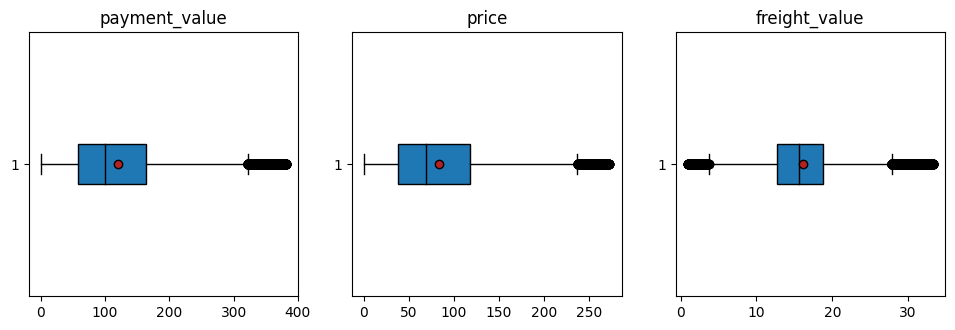

In [25]:
#APRES suppression des outliers
data_X=df25.select_dtypes(include=['float64'])

fig = plt.figure(figsize=(16, 24))

medianprops = {'color':"black"}
meanprops = {'marker':'o', 'markeredgecolor':'black',
            'markerfacecolor':'firebrick'}
liste=[]
titres=[]
    
for feat_idx in range(0,data_X.columns.size):
    ax = fig.add_subplot(6,4, (feat_idx+1))

    data=data_X.loc[(data_X.iloc[:,feat_idx]==data_X.iloc[:,feat_idx]),:]
    data=data.iloc[:,feat_idx]
    liste.append(data)
    titres.append(feat_idx)

    h=plt.boxplot(data, showfliers=True, medianprops=medianprops, 
                vert=False, patch_artist=True, showmeans=True, meanprops=meanprops)
    plt.title(data_X.columns[feat_idx])

## <a name="C71">2-6 : nettoyage des étiquettes</a>

In [26]:
df26=df25.copy()
for i in df26.select_dtypes(include=[object]).columns :
    print(i,' : ', df26[i].unique(),'\n')

review_id  :  ['7bc2406110b926393aa56f80a40eba40' 'e2655da8bccce2ddc2f43cc2c80d24f3'
 'cb18f53b563f0bdeb76be0376ddd6b6a' ... '23c7909ca13562e6e688325ec7cfc71d'
 'ba05c849d293b35fb1ebe084bf151981' '8d1145a143835cf50010806970d5a9c2'] 

order_id  :  ['73fc7af87114b39712e6da79b0a377eb' '19721d59a9764437477eff0730b48665'
 'efd626e6a12a82d76e456e34093f8356' ... 'c9b32e9554b777f810bdc8c33940c026'
 'd32c308cae5b8c416907dc360ac819fe' 'df832acdcfc236969ab361d4597e6e0a'] 

review_comment_title  :  [nan 'Antes do Prazo' 'Recomendo' ... 'Atenção ' 'Nota fiscal'
 'Ótimo antes prazo'] 

review_comment_message  :  [nan 'Quem entregou foi outra distribuidora. Mas o pedido estava certo. '
 'Entregue antes do prazo.' ...
 'Demorou um pouco a chagar o produto, mas foi dentro do prazo.'
 'Menor do que imaginava a foto demonstra que maior mas ficou bonitinho '
 'denrtro do esperado'] 

review_creation_date  :  ['2018-01-18 00:00:00' '2018-04-10 00:00:00' '2017-12-28 00:00:00'
 '2018-03-17 00:00:00' '2018-04

customer_state  :  ['SP' 'RS' 'MG' 'RJ' 'PE' 'GO' 'RN' 'AM' 'DF' 'BA' 'PB' 'CE' 'SC' 'PR'
 'ES' 'MT' 'SE' 'PA' 'AC' 'MS' 'MA' 'AL' 'TO' 'PI' 'RO' 'AP' 'RR'] 

payment_type  :  ['credit_card' 'boleto' 'voucher' 'debit_card' nan 'not_defined'] 

product_id  :  ['fd25ab760bfbba13c198fa3b4f1a0cd3' '1acb18fc869c5489d5f76abcd681165e'
 '45faac1ea8c173bb8c3e6cf23f5aac4e' ... '74356542db3483a78a8ba69f5b7ea094'
 '57646b730d659bc73d8193fc5131014b' 'e0714d4d2e52b1fbc8e851dac210333a'] 

seller_id  :  ['6d803cb79cc31c41c4c789a75933b3c7' '165fc07beebdcb6190fba8a06db2a449'
 '989becdce12ebc39863c2bceab6f3ca1' ... 'c3aad7dc65449ae90a5e9c3c6c1e78e0'
 '3296662b1331dea51e744505065ae889' 'd7f1cfc638473be93baedbfd02208016'] 

shipping_limit_date  :  ['2018-01-18 15:47:59' '2018-04-02 11:15:38' '2017-12-14 20:51:05' ...
 '2017-11-13 03:10:23' '2017-12-07 14:17:06' '2017-11-21 03:06:46'] 

seller_zip_code_prefix  :  [14600.0 87015.0 81730.0 ... 17201.0 5615.0 26112.0] 

seller_city  :  ['sao joaquim da barra' 

RAS à ce stade

In [27]:
df26.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 116473 entries, 0 to 119142
Data columns (total 29 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   review_id                      115592 non-null  object        
 1   order_id                       116473 non-null  object        
 2   review_score                   115592 non-null  Int64         
 3   review_comment_title           13728 non-null   object        
 4   review_comment_message         48586 non-null   object        
 5   review_creation_date           115592 non-null  object        
 6   review_answer_timestamp        115592 non-null  object        
 7   customer_id                    116473 non-null  object        
 8   order_status                   116473 non-null  object        
 9   order_purchase_timestamp       116473 non-null  datetime64[ns]
 10  order_delivered_customer_date  115722 non-null  datetime64[ns]
 11  

# <a name="A3">**Partie 3 : Exploration**</a>

## <a name="C8">3-1 : Analyse Univariée</a>

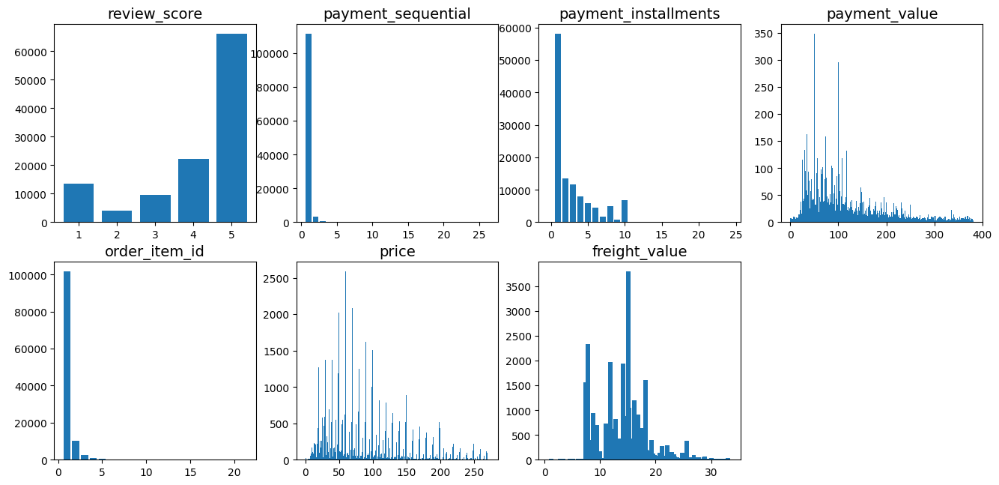

In [28]:
df31=df26.copy()
fig = plt.figure(figsize=(16, 24))
for feat_idx in range(0,df31.select_dtypes(include=['float64','Int64']).columns.size):
        graph = fig.add_subplot(6,4, (feat_idx+1))

        freq = pd.value_counts(df31.select_dtypes(include=['float64','Int64']).iloc[:, feat_idx].to_numpy())
        bins = freq.index
        x=graph.bar(bins, freq.values) #gives the graph without NaN
        graph.set_title(df31.select_dtypes(include=['float64','Int64']).columns[feat_idx], fontsize=14)

## 3-1-a Les clients sont situés majoritairement sur la cote est du Brésil

In [29]:
df31a=pd.merge(c,g,left_on='customer_zip_code_prefix',right_on='geolocation_zip_code_prefix',how='left')

In [30]:
df31aa=df31a.loc[df31a.duplicated(subset=['customer_unique_id'],keep='first')==False,:]

In [31]:
df31aa.dropna(axis=0,how='any', inplace=True)

C:\Users\John\AppData\Local\Temp\ipykernel_8268\257363663.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df31aa.dropna(axis=0,how='any', inplace=True)


In [32]:
#Visualisation géographique des clients
bresil_map = folium.Map(location=[-14.242915, -53.189266], zoom_start=11)

marker_cluster = folium.plugins.MarkerCluster().add_to(bresil_map)
for lat, lng, in zip(df31aa.geolocation_lat, df31aa.geolocation_lng):
    folium.Marker(location=[lat, lng]).add_to(marker_cluster)
bresil_map

## 3-1-b Les vendeurs sont situés majoritairement au sud-est du Brésil

In [33]:
df31b=pd.merge(s,g,left_on='seller_zip_code_prefix',right_on='geolocation_zip_code_prefix',how='left')

In [34]:
df31ba=df31b.loc[df31b.duplicated(subset=['seller_id'],keep='first')==False,:]

In [35]:
df31ba.dropna(axis=0,how='any', inplace=True)

C:\Users\John\AppData\Local\Temp\ipykernel_8268\2419446295.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df31ba.dropna(axis=0,how='any', inplace=True)


In [36]:
### Visualisation géographique des clients
bresil_map = folium.Map(location=[-14.242915, -53.189266], zoom_start=11)

marker_cluster = folium.plugins.MarkerCluster().add_to(bresil_map)
for lat, lng, in zip(df31ba.geolocation_lat, df31ba.geolocation_lng):
    folium.Marker(location=[lat, lng]).add_to(marker_cluster)
bresil_map

## 3-1-c_ Répartition des commandes par 'order_status'

In [37]:
#en quantité
o.groupby('order_status').size()

order_status
approved           2
canceled         625
created            5
delivered      96478
invoiced         314
processing       301
shipped         1107
unavailable      609
dtype: int64

## 3-1-c Les produits les plus achetés sont

In [38]:
df31c=o.merge(oi,on='order_id',how='left')
df31c=df31c.merge(p,on='product_id',how='left')
df31c=df31c.merge(pc,on='product_category_name',how='left')

In [39]:
df31c.dropna(axis=0,how='any', inplace=True)

In [40]:
df31ca=df31c.loc[df31c['order_status']=='delivered',['product_category_name_english','order_status']].reset_index()

In [41]:
df31cb=pd.DataFrame(df31ca.groupby(['product_category_name_english'])['order_status'].count().sort_values(ascending=False))
df31ca['product_category_name_english'].unique().size

71

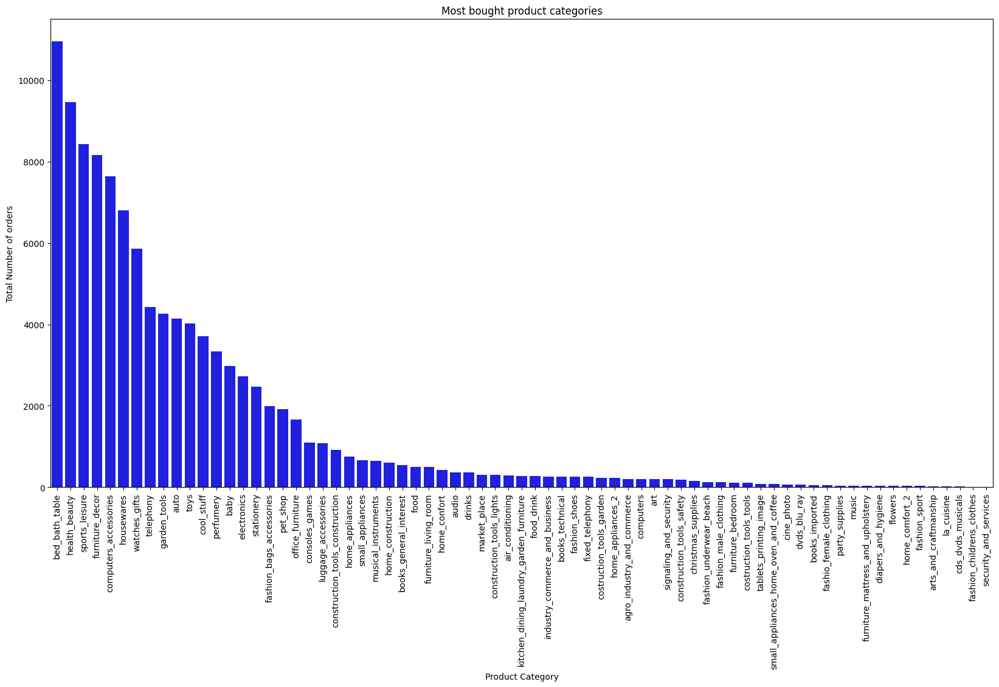

In [42]:
### Visualising top 10 most bought product categories:
plt.figure(figsize=(20,10))
sns.barplot(x=df31cb.index,y=df31cb['order_status'],data=df31cb,color="blue")
plt.xlabel("Product Category")
plt.ylabel("Total Number of orders")
plt.title("Most bought product categories")
plt.xticks(rotation='vertical')
plt.show()

### regroupement des 71 catégories en 11 catégories

In [43]:
df31r=df31.copy()

In [44]:
product_category={
'Maison_jardin' : ['home_confort', 'furniture_bedroom', 'furniture_living_room','home_appliances_2','housewares', 'furniture_decor', 'garden_tools', 'bed_bath_table', 'air_conditioning', 'small_appliances', 'luggage_accessories', 'home_appliances', 'kitchen_dining_laundry_garden_furniture', 'home_construction', 'home_comfort_2', 'small_appliances_home_oven_and_coffee',  'furniture_mattress_and_upholstery', 'signaling_and_security', 'flowers'],

'Mode_accessoires' : ['perfumery', 'fashion_underwear_beach', 'fashion_bags_accessories', 'fashion_shoes', 'fashion_sport', 'fashio_female_clothing', 'fashion_male_clothing', 'fashion_childrens_clothes'],

'Auto_moto' : ['auto'],

'Animaux_de_compagnie' : ['pet_shop'],

'Papeterie_bureau' : ['stationery', 'office_furniture'],

'High-tech_électronique' : ['security_and_services','computers_accessories', 'electronics', 'cool_stuff', 'watches_gifts', 'telephony', 'fixed_telephony', 'consoles_games', 'tablets_printing_image', 'audio', 'cine_photo', 'computers', 'dvds_blu_ray'],

'Santé_beauté' : ['health_beauty'],

'Enfant_bébé' : ['toys', 'baby', 'diapers_and_hygiene'],

'Outils_construction' : ['costruction_tools_tools','construction_tools_construction', 'construction_tools_lights', 'costruction_tools_garden', 'construction_tools_safety'],

'Loisirs_culture_divertissement' : ['arts_and_craftmanship','sports_leisure', 'books_general_interest', 'books_technical', 'cds_dvds_musicals', 'music', 'arts_and_craftsmanship', 'books_imported', 'christmas_supplies', 'drinks', 'food_drink', 'la_cuisine', 'industry_commerce_and_business', 'market_place', 'agro_industry_and_commerce', 'party_supplies', 'art', 'musical_instruments'],

'Alimentation' : ['food']}  


In [45]:
for k in product_category:
    for v in product_category[k]:
        df31r.loc[df31r['product_category_name_english']==v,'product_category_name_english']=k

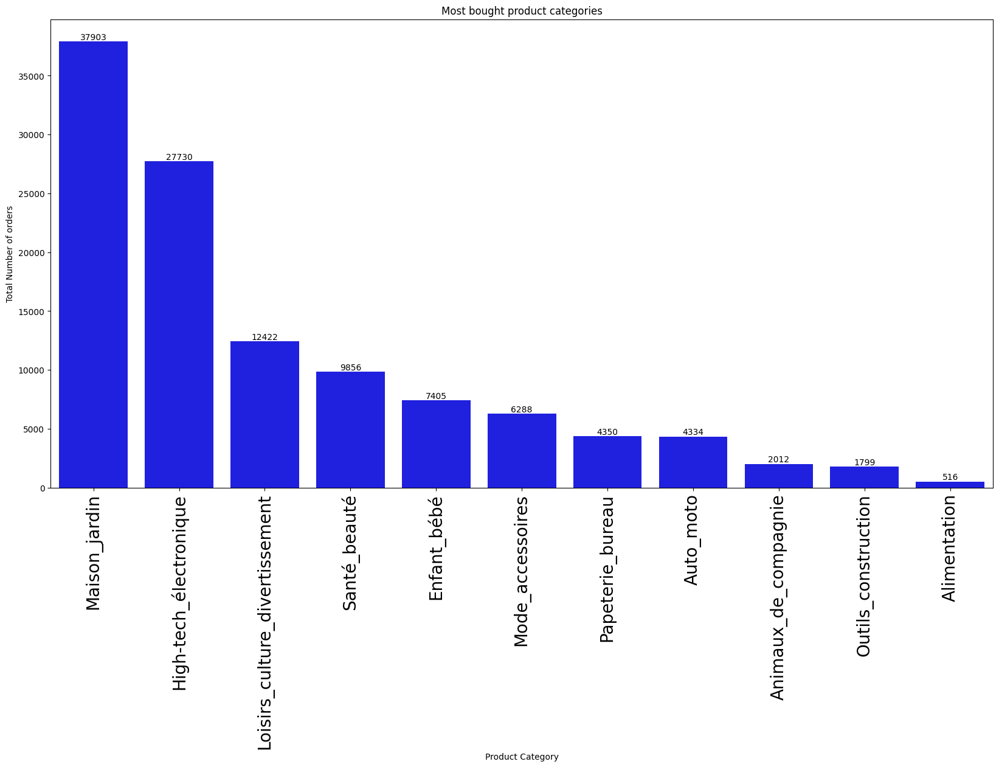

In [46]:
### Visualising top 10 most bought product categories:
df31rcb = df31r.loc[(df31r['order_status']=='delivered') | (df31r['order_status']=='canceled'),: ]

df31rcb = pd.DataFrame(df31rcb.groupby(['product_category_name_english'])['order_status'].count().sort_values(ascending=False))

plt.figure(figsize=(20,10))
ax = sns.barplot(x=df31rcb.index,y=df31rcb['order_status'],data=df31rcb,color="blue")
ax.bar_label(ax.containers[0])
plt.xlabel("Product Category")
plt.ylabel("Total Number of orders")
plt.title("Most bought product categories")
plt.xticks(rotation='vertical',fontsize=20)
plt.show()

## 3-1-d L'évolution du nombre de ventes en fonction du temps

In [47]:
df31d=pd.DataFrame(o.loc[o['order_status']=='delivered', 'order_delivered_customer_date'])

In [48]:
df31d['date']=df31d['order_delivered_customer_date'].astype('datetime64[s]')

In [49]:
df31d.dropna(axis='rows',how='any',inplace=True)

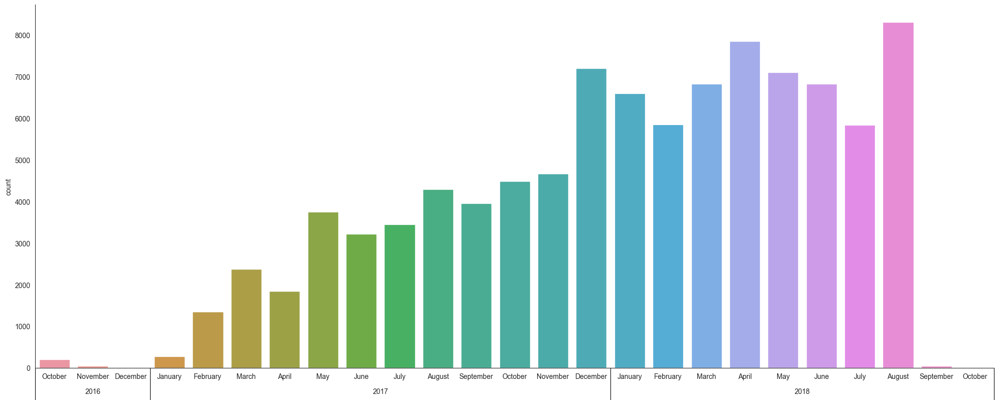

In [50]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


months = pd.date_range('2016-01-01', periods=12, freq='M').strftime('%B')

df31d['Year'] = df31d['date'].dt.year
df31d['YearMonth'] = df31d['date'].dt.strftime('%Y%m').astype(int)

sns.set_style("white")
sns.set_color_codes("pastel")
fig, ax = plt.subplots(figsize=(20, 8))
sns.countplot(x='YearMonth', data=df31d, ax=ax)
sns.despine()
yearmonth_labels = [int(l.get_text()) for l in ax.get_xticklabels()]
ax.set_xticklabels([months[ym % 100 - 1] for ym in yearmonth_labels])
ax.set_xlabel('')

# calculate the positions of the borders between the years
pos = []
years = []
prev = None
for i, ym in enumerate(yearmonth_labels):
    if ym // 100 != prev:
        pos.append(i)
        prev = ym // 100
        years.append(prev)
pos.append(len(yearmonth_labels))
pos = np.array(pos) - 0.5
# vertical lines to separate the years
ax.vlines(pos, 0, -0.12, color='black', lw=0.8, clip_on=False, transform=ax.get_xaxis_transform())
# years at the center of their range
for year, pos0, pos1 in zip(years, pos[:-1], pos[1:]):
    ax.text((pos0 + pos1) / 2, -0.07, year, ha='center', clip_on=False, transform=ax.get_xaxis_transform())

ax.set_xlim(pos[0], pos[-1])
ax.set_ylim(ymin=0)
plt.tight_layout()
plt.show()

## 3-1-e L'évolution du chiffre d'affaire en fonction du temps

In [51]:
df31e=o.merge(op,on='order_id',how='left')

In [52]:
df31e=pd.DataFrame(df31e.loc[df31e['order_status']=='delivered', ['order_delivered_customer_date','payment_value']])
df31e=df31e.loc[:,['order_delivered_customer_date','payment_value']]

In [53]:
df31e['date']=df31e['order_delivered_customer_date'].astype('datetime64[s]')

In [54]:
df31e.dropna(axis='rows',how='any',inplace=True)

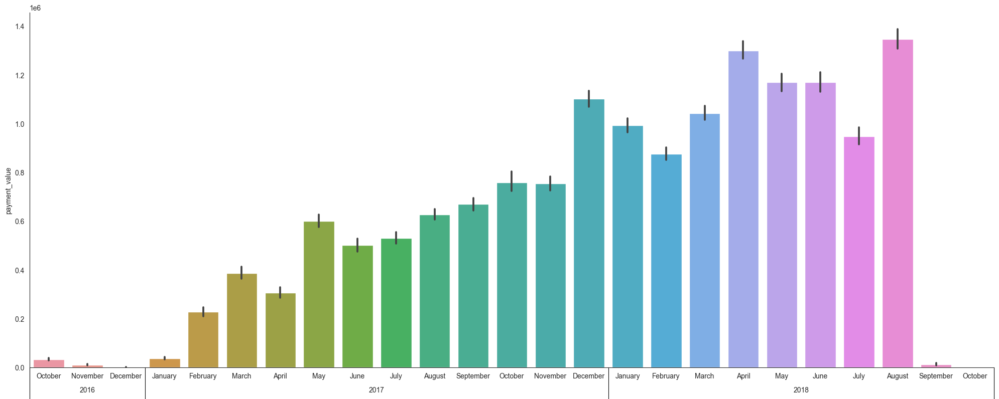

In [55]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

months = pd.date_range('2016-01-01', periods=12, freq='M').strftime('%B')

df31e['Year'] = df31e['date'].dt.year

df31e['YearMonth'] = df31e['date'].dt.strftime('%Y%m').astype(int)

sns.set_style("white")
sns.set_color_codes("pastel")
fig, ax = plt.subplots(figsize=(20, 8))
sns.barplot(x='YearMonth', y='payment_value',estimator='sum',data=df31e.loc[:,['YearMonth','payment_value']], ax=ax)
sns.despine()
yearmonth_labels = [int(l.get_text()) for l in ax.get_xticklabels()]
ax.set_xticklabels([months[ym % 100 - 1] for ym in yearmonth_labels])
ax.set_xlabel('')

# calculate the positions of the borders between the years
pos = []
years = []
prev = None
for i, ym in enumerate(yearmonth_labels):
    if ym // 100 != prev:
        pos.append(i)
        prev = ym // 100
        years.append(prev)
pos.append(len(yearmonth_labels))
pos = np.array(pos) - 0.5
# vertical lines to separate the years
ax.vlines(pos, 0, -0.12, color='black', lw=0.8, clip_on=False, transform=ax.get_xaxis_transform())
# years at the center of their range
for year, pos0, pos1 in zip(years, pos[:-1], pos[1:]):
    ax.text((pos0 + pos1) / 2, -0.07, year, ha='center', clip_on=False, transform=ax.get_xaxis_transform())

ax.set_xlim(pos[0], pos[-1])
ax.set_ylim(ymin=0)
plt.tight_layout()
plt.show()

## 3-1-f Répartition des moyens de paiement

In [56]:
df31f=o.merge(op,on='order_id',how='left')

In [57]:
df31f=df31f.loc[df31f['order_status']=='delivered',['payment_type']]#.dropna(axis=0,how='any',inplace=True)
df31f.dropna(axis=0,how='any',inplace=True)

In [58]:
df31f.value_counts()

payment_type
credit_card     74586
boleto          19191
voucher          5493
debit_card       1486
dtype: int64

In [59]:
df31f.value_counts().index

MultiIndex([('credit_card',),
            (     'boleto',),
            (    'voucher',),
            ( 'debit_card',)],
           names=['payment_type'])

([<matplotlib.patches.Wedge at 0x2c2b29c3af0>,
 [Text(-0.7536655550293685, 0.801241680869308, "('credit_card',)"),
  Text(0.5629089941034134, -0.9450573868064751, "('boleto',)"),
  Text(1.0619063605389127, -0.28697540216367123, "('voucher',)"),
  Text(1.0988194506249398, -0.05094914060419109, "('debit_card',)")],
 [Text(-0.41109030274329184, 0.4370409168378044, '74.0%'),
  Text(0.3070412695109528, -0.5154858473489864, '19.0%'),
  Text(0.5792216512030433, -0.15653203754382064, '5.5%'),
  Text(0.5993560639772398, -0.027790440329558772, '1.5%')])

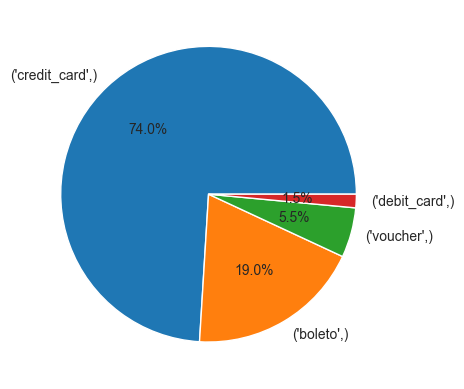

In [60]:
plt.pie(list(df31f.value_counts()),labels=df31f.value_counts().index,autopct='%1.1f%%')

## 3-1-g le niveau de satisfaction des clients

In [61]:
df31g=o.merge(ore,on='order_id',how='left')

In [62]:
df31g=df31g.loc[:,['review_score']]#.dropna(axis=0,how='any',inplace=True)
df31g.dropna(axis=0,how='any',inplace=True)

In [63]:
df31g.value_counts()

review_score
5.0             57328
4.0             19142
1.0             11424
3.0              8179
2.0              3151
dtype: int64

([<matplotlib.patches.Wedge at 0x2c2b2a2d4c0>,
 [Text(-0.26606600291560784, 1.067337286003123, '(5.0,)'),
  Text(-0.5041749146956596, -0.9776541593997463, '(4.0,)'),
  Text(0.5192810518969201, -0.9697150040815231, '(1.0,)'),
  Text(0.9863930547516611, -0.48685597617538484, '(3.0,)'),
  Text(1.0945302690418386, -0.10956044063073417, '(2.0,)')],
 [Text(-0.14512691068124062, 0.5821839741835215, '57.8%'),
  Text(-0.2750044989249052, -0.5332659051271342, '19.3%'),
  Text(0.28324421012559275, -0.5289354567717398, '11.5%'),
  Text(0.5380325753190878, -0.2655578051865735, '8.2%'),
  Text(0.5970165103864573, -0.059760240344036805, '3.2%')])

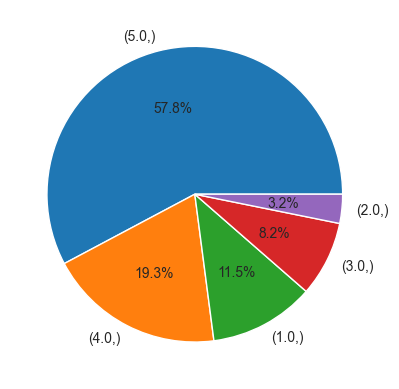

In [64]:
plt.pie(list(df31g.value_counts()),labels=df31g.value_counts().index,autopct='%1.1f%%')

## 3-1-h la distribution des montants dépensés par les clients par opération

In [65]:
payment=op[op['payment_value']!=0]

Text(0.5, 33.33215555555556, 'Log10 Payment_value')

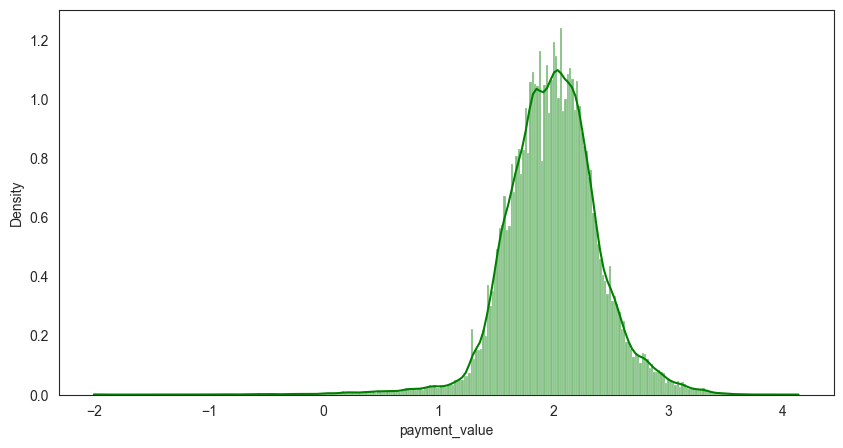

In [66]:
payment=op[op['payment_value']!=0]
plt.figure(figsize=(10,5))
sns.histplot(np.log10(payment['payment_value']),color="green",kde=True, stat="density")

ax.set_xlabel("Log10 Payment_value")

In [67]:
payment.describe().iloc[:,2]

count    103877.000000
mean        154.113732
std         217.498755
min           0.010000
25%          56.820000
50%         100.000000
75%         171.840000
max       13664.080000
Name: payment_value, dtype: float64

## 3-1-i Distribution du nombre de commandes par client

In [68]:
df31i=o.merge(c,on='customer_id',how='left')

In [69]:
df31i=df31i.groupby('customer_unique_id').count()

In [70]:
df31i.groupby('order_id').size()

order_id
1     93099
2      2745
3       203
4        30
5         8
6         6
7         3
9         1
17        1
dtype: int64

In [71]:
list(df31i.groupby('order_id').size().index)

[1, 2, 3, 4, 5, 6, 7, 9, 17]

In [72]:
list(df31i.groupby('order_id').size().values)

[93099, 2745, 203, 30, 8, 6, 3, 1, 1]

Text(0.5, 0, 'order_quantity')

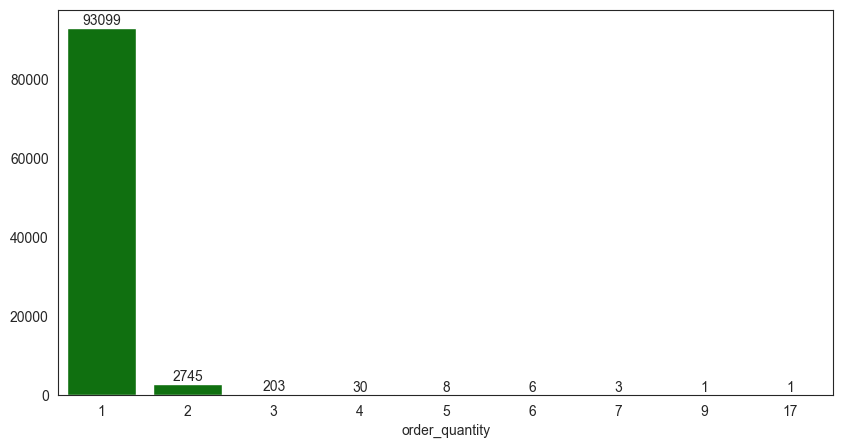

In [73]:
nb_dachat=df31i['order_id']
plt.figure(figsize=(10,5))
ax = sns.barplot(x=list(df31i.groupby('order_id').size().index), y=list(df31i.groupby('order_id').size().values),color="green")
ax.bar_label(ax.containers[0])
ax.set_xlabel("order_quantity")

In [74]:
# Proprotion des clients qui ont fait plus d'une commande
(2745+203+30+8+6+3+1+1)/((2745+203+30+8+6+3+1+1)+93099)

0.031187562437562436

## 3-1-j délais de livraison

In [75]:
df31j=c.merge(o,on='customer_id',how='left')
df31j=df31j.merge(oi,on='order_id',how='left')
df31j=df31j.merge(s,on='seller_id',how='left')
df31j=df31j.loc[df31j['order_status']=='delivered',:]

In [76]:
df31j['order_delivered_customer_date']=df31j['order_delivered_customer_date'].astype('datetime64[s]')
df31j['order_purchase_timestamp']=df31j['order_purchase_timestamp'].astype('datetime64[s]')

In [77]:
df31j['delai']=df31j['order_delivered_customer_date']-df31j['order_purchase_timestamp']

In [78]:
df31j.reset_index(drop=True, inplace=True)

In [79]:
for j in range(df31j.shape[0]):
    df31j.loc[j,'delai']=df31j.loc[j,'delai'].days

Text(0.5, 24.140625, 'délai')

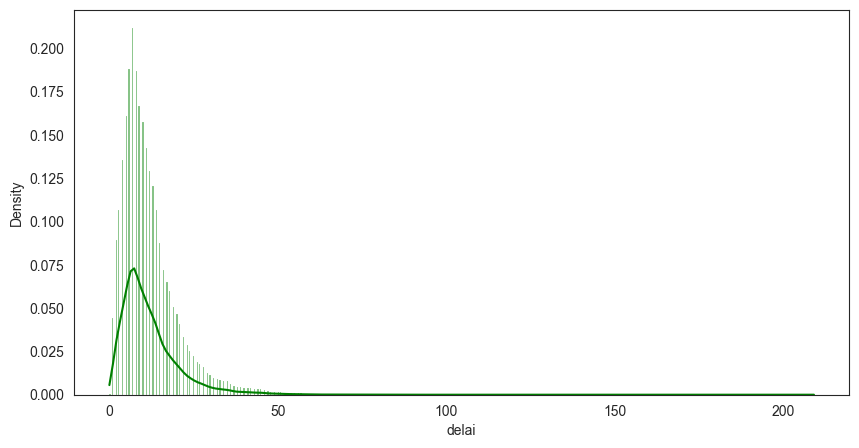

In [80]:
plt.figure(figsize=(10,5))
sns.histplot(df31j['delai'],color="green",kde=True, stat="density")

ax.set_xlabel("délai")

In [81]:
df31j['delai'].astype('Int64').describe()

count     110189.0
mean     12.007342
std       9.451153
min            0.0
25%            6.0
50%           10.0
75%           15.0
max          209.0
Name: delai, dtype: Float64

## <a name="C9">3-2 : Analyse Bivariée</a>

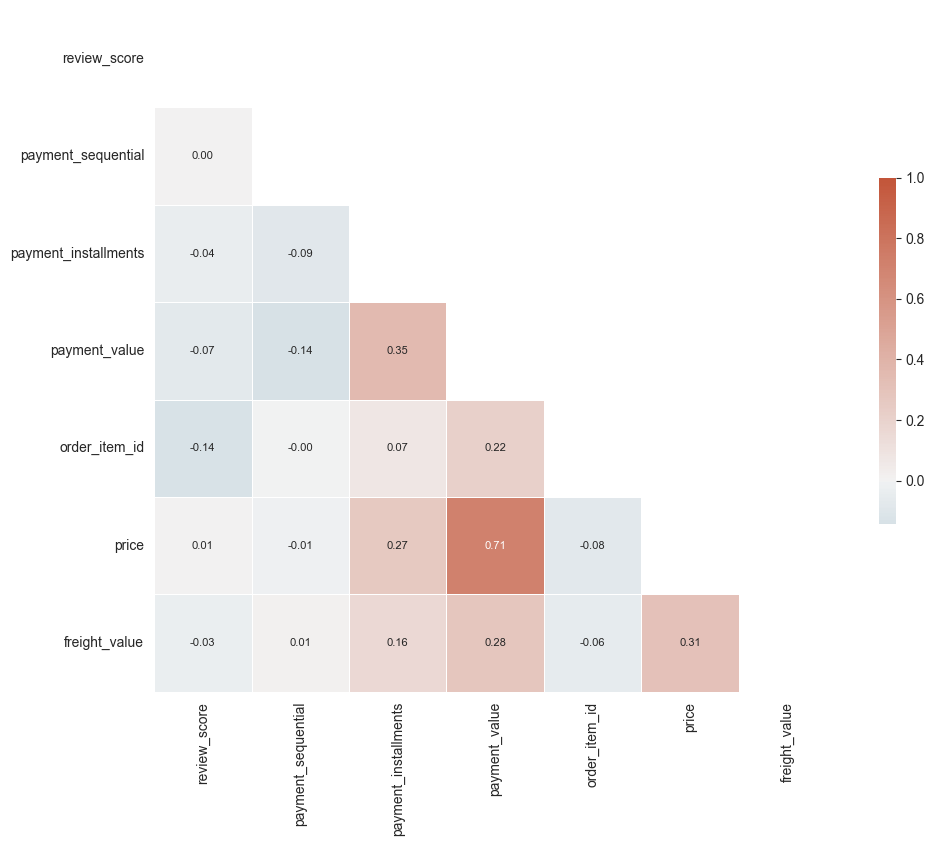

In [82]:
df32=df31.copy()
# Compute the correlation matrix
corr = df32.select_dtypes(include=['int64','float64']).corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5},annot=True, fmt=".2f", annot_kws={'size':8});

C:\Users\John\Desktop\Formation\venv\lib\site-packages\seaborn\distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
C:\Users\John\Desktop\Formation\venv\lib\site-packages\seaborn\distributions.py:500: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(widths, name="widths"),
C:\Users\John\Desktop\Formation\venv\lib\site-packages\seaborn\distributions.py:499: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  pd.Index(edges, name="edges"),
C:\Users\John\Desktop\Formation\venv\lib\site-packages\seaborn\distributions.py:500: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dt

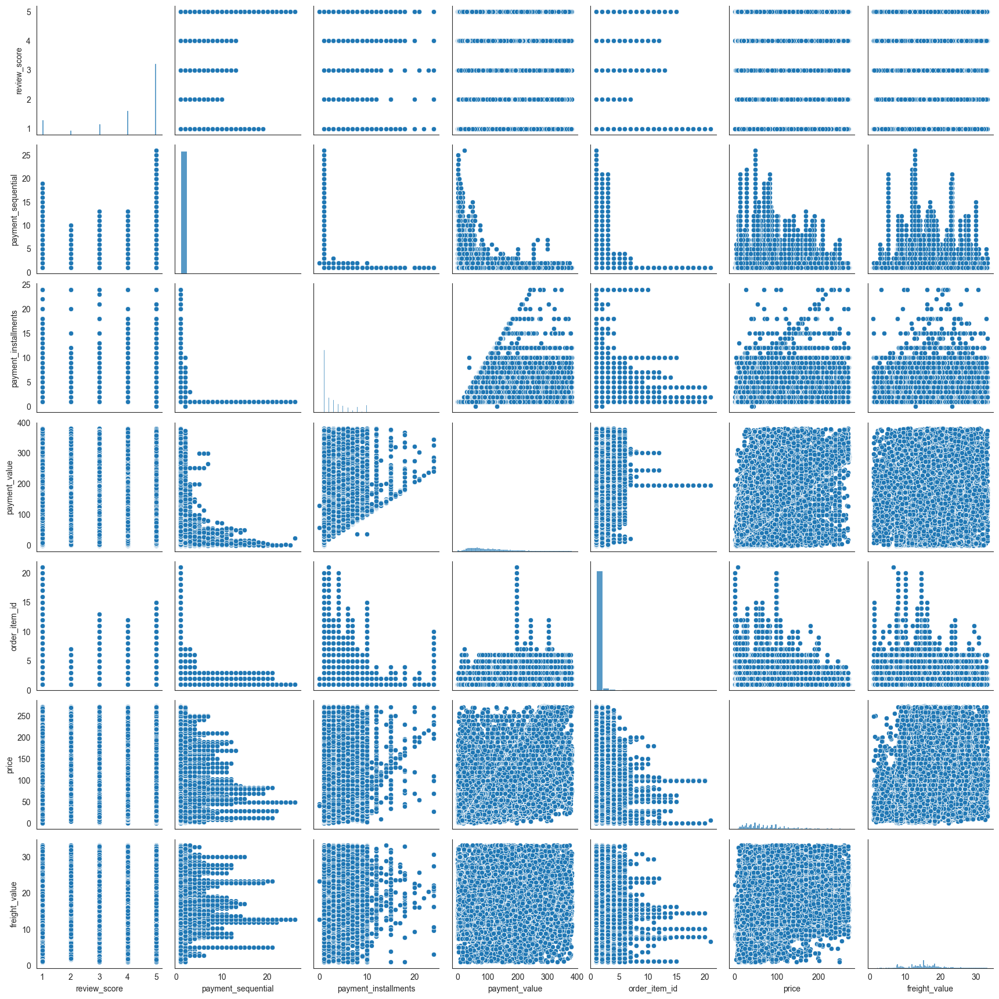

In [83]:
sns.pairplot(df32.select_dtypes(include=['int64','float64']))

## <a name="C10">3-3 : Feature engineering</a>

## 3-3-a Suppression de variables

<AxesSubplot: >

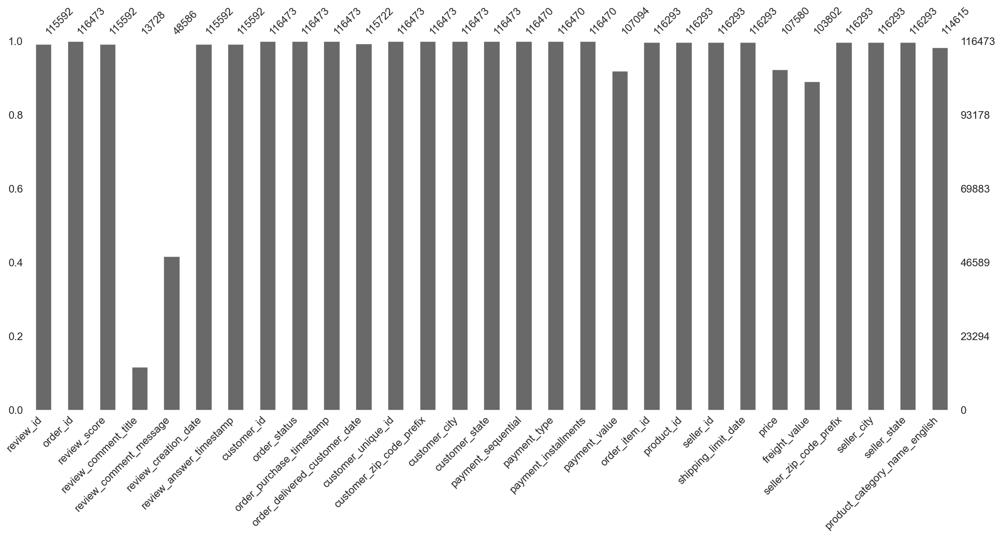

In [84]:
msno.bar(df26)

In [85]:
df33a=df26.drop(columns=['review_comment_title','review_comment_message'])

In [86]:
df33a.to_csv('df33a.csv',index=False)

## 3-3-b Imputation des colonnes

In [87]:
df33a.isna().mean()

review_id                        0.007564
order_id                         0.000000
review_score                     0.007564
review_creation_date             0.007564
review_answer_timestamp          0.007564
customer_id                      0.000000
order_status                     0.000000
order_purchase_timestamp         0.000000
order_delivered_customer_date    0.006448
customer_unique_id               0.000000
customer_zip_code_prefix         0.000000
customer_city                    0.000000
customer_state                   0.000000
payment_sequential               0.000026
payment_type                     0.000026
payment_installments             0.000026
payment_value                    0.080525
order_item_id                    0.001545
product_id                       0.001545
seller_id                        0.001545
shipping_limit_date              0.001545
price                            0.076352
freight_value                    0.108789
seller_zip_code_prefix           0

In [88]:
df33b=df33a.copy()

In [89]:
for i in df33b.columns:
    mode = df33b[i].mode()[0]
    df33b[i].fillna(mode, inplace=True)

<AxesSubplot: >

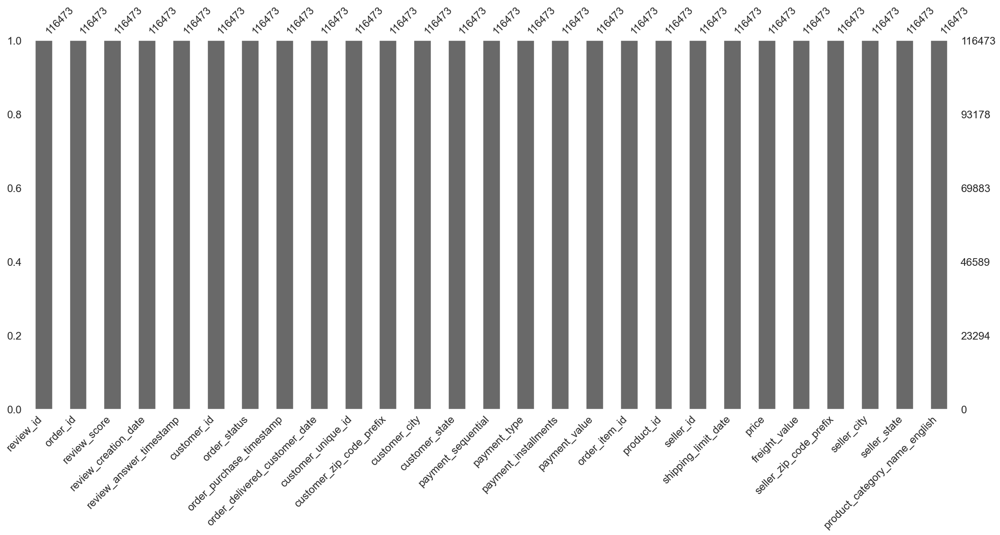

In [90]:
msno.bar(df33b)

In [91]:
#on va réduire le nombre de catégories dans la colonnes 'product_category_name_english'
product_category={
'Maison_jardin' : ['home_confort', 'furniture_bedroom', 'furniture_living_room','home_appliances_2','housewares', 'furniture_decor', 'garden_tools', 'bed_bath_table', 'air_conditioning', 'small_appliances', 'luggage_accessories', 'home_appliances', 'kitchen_dining_laundry_garden_furniture', 'home_construction', 'home_comfort_2', 'small_appliances_home_oven_and_coffee',  'furniture_mattress_and_upholstery', 'signaling_and_security', 'flowers'],

'Mode_accessoires' : ['perfumery', 'fashion_underwear_beach', 'fashion_bags_accessories', 'fashion_shoes', 'fashion_sport', 'fashio_female_clothing', 'fashion_male_clothing', 'fashion_childrens_clothes'],

'Auto_moto' : ['auto'],

'Animaux_de_compagnie' : ['pet_shop'],

'Papeterie_bureau' : ['stationery', 'office_furniture'],

'High-tech_électronique' : ['security_and_services','computers_accessories', 'electronics', 'cool_stuff', 'watches_gifts', 'telephony', 'fixed_telephony', 'consoles_games', 'tablets_printing_image', 'audio', 'cine_photo', 'computers', 'dvds_blu_ray'],

'Santé_beauté' : ['health_beauty'],

'Enfant_bébé' : ['toys', 'baby', 'diapers_and_hygiene'],

'Outils_construction' : ['costruction_tools_tools','construction_tools_construction', 'construction_tools_lights', 'costruction_tools_garden', 'construction_tools_safety'],

'Loisirs_culture_divertissement' : ['arts_and_craftmanship','sports_leisure', 'books_general_interest', 'books_technical', 'cds_dvds_musicals', 'music', 'arts_and_craftsmanship', 'books_imported', 'christmas_supplies', 'drinks', 'food_drink', 'la_cuisine', 'industry_commerce_and_business', 'market_place', 'agro_industry_and_commerce', 'party_supplies', 'art', 'musical_instruments'],

'Alimentation' : ['food']}  


In [92]:
for k in product_category:
    for v in product_category[k]:
        df33b.loc[df33b['product_category_name_english']==v,'product_category_name_english']=k

<AxesSubplot: >

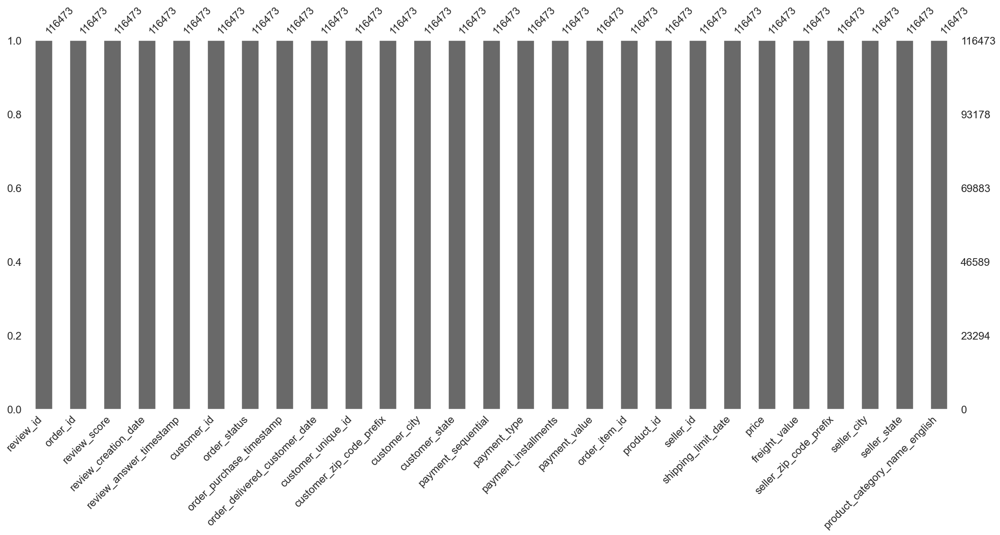

In [93]:
msno.bar(df33b)

In [94]:
df33b.to_csv('df33b.csv',index=False)

## 3-3-c Définition de nouvelles variables

In [101]:
df33cr = df33b.copy()

In [108]:
dt_base = datetime.datetime.strptime('2018-10-17','%Y-%m-%d')

In [103]:
#tri de la base par date d'achat
df33cr = df33cr.sort_values('order_purchase_timestamp')

In [104]:
#colonne payment cumulé
df33cr['payment_cum'] = df33cr[['customer_unique_id', 'payment_value']].groupby('customer_unique_id').cumsum()
df33cr.loc[df33cr.customer_unique_id=='8d50f5eadf50201ccdcedfb9e2ac8455',['order_purchase_timestamp','payment_cum']].head()

,order_purchase_timestamp,payment_cum
5761,2017-06-18 22:56:48,51.75
110965,2017-07-18 23:10:58,73.52
4015,2017-07-24 22:11:50,240.23
86280,2017-08-05 08:59:43,322.12
2785,2017-09-05 22:14:52,373.87


In [105]:
#colonne date purchasing mini
dfcrg = df33cr[['customer_unique_id', 'order_purchase_timestamp']].groupby('customer_unique_id').min()
dfcrg = dfcrg.reset_index()
dfcrg['order_purchase_date_min'] = dfcrg['order_purchase_timestamp']
dfcrg.drop(columns='order_purchase_timestamp',inplace=True)
df33cr = df33cr.merge(dfcrg, on = 'customer_unique_id', how = 'left')
df33cr.loc[df33cr.customer_unique_id=='8d50f5eadf50201ccdcedfb9e2ac8455',:].head()

,review_id,order_id,review_score,review_creation_date,review_answer_timestamp,customer_id,order_status,order_purchase_timestamp,order_delivered_customer_date,customer_unique_id,...,seller_id,shipping_limit_date,price,freight_value,seller_zip_code_prefix,seller_city,seller_state,product_category_name_english,payment_cum,order_purchase_date_min
15968,7ecc7adba17766dab9097a0116a75a66,369634708db140c5d2c4e365882c443a,5,2017-06-25 00:00:00,2017-06-26 20:53:55,b2b13de0770e06de50080fea77c459e6,delivered,2017-06-18 22:56:48,2017-06-23 12:55:50,8d50f5eadf50201ccdcedfb9e2ac8455,...,94e93ce877be27a515118dbfd2c2be41,2017-06-22 23:10:19,39.90,11.85,15502.0,votuporanga,SP,Loisirs_culture_divertissement,51.75,2017-06-18 22:56:48
20083,cb44e7ba6bacbf6f348aec2b9ab56790,4f62d593acae92cea3c5662c76122478,5,2017-07-22 00:00:00,2017-07-24 12:52:56,dfb941d6f7b02f57a44c3b7c3fefb44b,delivered,2017-07-18 23:10:58,2017-07-21 16:19:40,8d50f5eadf50201ccdcedfb9e2ac8455,...,1da3aeb70d7989d1e6d9b0e887f97c23,2017-07-24 23:23:26,13.99,7.78,4265.0,sao paulo,SP,Mode_accessoires,73.52,2017-06-18 22:56:48
20989,8858e37108a15029eef04f510161fb8a,bf92c69b7cc70f7fc2c37de43e366173,5,2017-08-01 00:00:00,2017-08-02 01:22:24,42dbc1ad9d560637c9c4c1533746f86d,delivered,2017-07-24 22:11:50,2017-07-31 16:59:58,8d50f5eadf50201ccdcedfb9e2ac8455,...,a3a38f4affed601eb87a97788c949667,2017-07-30 22:25:14,149.90,16.81,89204.0,joinville,SC,Loisirs_culture_divertissement,240.23,2017-06-18 22:56:48
22831,c40b5c0ee4779d9f1c25da03503943e1,519203404f6116d406a970763ee75799,5,2017-08-10 00:00:00,2017-08-11 03:39:10,1c62b48fb34ee043310dcb233caabd2e,delivered,2017-08-05 08:59:43,2017-08-09 15:22:28,8d50f5eadf50201ccdcedfb9e2ac8455,...,94e93ce877be27a515118dbfd2c2be41,2017-08-10 09:10:13,69.90,11.99,15502.0,votuporanga,SP,Maison_jardin,322.12,2017-06-18 22:56:48
28097,fa2449a730e7e4a66f698977f6ab3802,e3071b7624445af6e4f3a1b23718667d,5,2017-09-12 00:00:00,2017-09-13 01:39:44,0bf8bf19944a7f8b40ba86fef778ca7c,delivered,2017-09-05 22:14:52,2017-09-11 13:27:49,8d50f5eadf50201ccdcedfb9e2ac8455,...,fdaaf5bfda82b7b80535610c831b8d09,2017-09-12 22:30:56,39.90,11.85,15015.0,sao jose do rio preto,SP,Loisirs_culture_divertissement,373.87,2017-06-18 22:56:48


In [106]:
#colonne nb d'achats cumulé
df33cr['purchase_count'] = df33cr[['customer_unique_id', 'payment_value']].groupby('customer_unique_id').cumcount()+1
df33cr.loc[df33cr.customer_unique_id=='8d50f5eadf50201ccdcedfb9e2ac8455',:].head()

,review_id,order_id,review_score,review_creation_date,review_answer_timestamp,customer_id,order_status,order_purchase_timestamp,order_delivered_customer_date,customer_unique_id,...,shipping_limit_date,price,freight_value,seller_zip_code_prefix,seller_city,seller_state,product_category_name_english,payment_cum,order_purchase_date_min,purchase_count
15968,7ecc7adba17766dab9097a0116a75a66,369634708db140c5d2c4e365882c443a,5,2017-06-25 00:00:00,2017-06-26 20:53:55,b2b13de0770e06de50080fea77c459e6,delivered,2017-06-18 22:56:48,2017-06-23 12:55:50,8d50f5eadf50201ccdcedfb9e2ac8455,...,2017-06-22 23:10:19,39.90,11.85,15502.0,votuporanga,SP,Loisirs_culture_divertissement,51.75,2017-06-18 22:56:48,1
20083,cb44e7ba6bacbf6f348aec2b9ab56790,4f62d593acae92cea3c5662c76122478,5,2017-07-22 00:00:00,2017-07-24 12:52:56,dfb941d6f7b02f57a44c3b7c3fefb44b,delivered,2017-07-18 23:10:58,2017-07-21 16:19:40,8d50f5eadf50201ccdcedfb9e2ac8455,...,2017-07-24 23:23:26,13.99,7.78,4265.0,sao paulo,SP,Mode_accessoires,73.52,2017-06-18 22:56:48,2
20989,8858e37108a15029eef04f510161fb8a,bf92c69b7cc70f7fc2c37de43e366173,5,2017-08-01 00:00:00,2017-08-02 01:22:24,42dbc1ad9d560637c9c4c1533746f86d,delivered,2017-07-24 22:11:50,2017-07-31 16:59:58,8d50f5eadf50201ccdcedfb9e2ac8455,...,2017-07-30 22:25:14,149.90,16.81,89204.0,joinville,SC,Loisirs_culture_divertissement,240.23,2017-06-18 22:56:48,3
22831,c40b5c0ee4779d9f1c25da03503943e1,519203404f6116d406a970763ee75799,5,2017-08-10 00:00:00,2017-08-11 03:39:10,1c62b48fb34ee043310dcb233caabd2e,delivered,2017-08-05 08:59:43,2017-08-09 15:22:28,8d50f5eadf50201ccdcedfb9e2ac8455,...,2017-08-10 09:10:13,69.90,11.99,15502.0,votuporanga,SP,Maison_jardin,322.12,2017-06-18 22:56:48,4
28097,fa2449a730e7e4a66f698977f6ab3802,e3071b7624445af6e4f3a1b23718667d,5,2017-09-12 00:00:00,2017-09-13 01:39:44,0bf8bf19944a7f8b40ba86fef778ca7c,delivered,2017-09-05 22:14:52,2017-09-11 13:27:49,8d50f5eadf50201ccdcedfb9e2ac8455,...,2017-09-12 22:30:56,39.90,11.85,15015.0,sao jose do rio preto,SP,Loisirs_culture_divertissement,373.87,2017-06-18 22:56:48,5


In [109]:
#colonne fréquence = nb de commande/periode
df33cr['Frequence']=df33cr['purchase_count']/(-(df33cr['order_purchase_date_min']-dt_base).astype('int64'))
df33cr.loc[df33cr.customer_unique_id=='8d50f5eadf50201ccdcedfb9e2ac8455',:].head()

,review_id,order_id,review_score,review_creation_date,review_answer_timestamp,customer_id,order_status,order_purchase_timestamp,order_delivered_customer_date,customer_unique_id,...,price,freight_value,seller_zip_code_prefix,seller_city,seller_state,product_category_name_english,payment_cum,order_purchase_date_min,purchase_count,Frequence
15968,7ecc7adba17766dab9097a0116a75a66,369634708db140c5d2c4e365882c443a,5,2017-06-25 00:00:00,2017-06-26 20:53:55,b2b13de0770e06de50080fea77c459e6,delivered,2017-06-18 22:56:48,2017-06-23 12:55:50,8d50f5eadf50201ccdcedfb9e2ac8455,...,39.90,11.85,15502.0,votuporanga,SP,Loisirs_culture_divertissement,51.75,2017-06-18 22:56:48,1,2.386191e-17
20083,cb44e7ba6bacbf6f348aec2b9ab56790,4f62d593acae92cea3c5662c76122478,5,2017-07-22 00:00:00,2017-07-24 12:52:56,dfb941d6f7b02f57a44c3b7c3fefb44b,delivered,2017-07-18 23:10:58,2017-07-21 16:19:40,8d50f5eadf50201ccdcedfb9e2ac8455,...,13.99,7.78,4265.0,sao paulo,SP,Mode_accessoires,73.52,2017-06-18 22:56:48,2,4.772382e-17
20989,8858e37108a15029eef04f510161fb8a,bf92c69b7cc70f7fc2c37de43e366173,5,2017-08-01 00:00:00,2017-08-02 01:22:24,42dbc1ad9d560637c9c4c1533746f86d,delivered,2017-07-24 22:11:50,2017-07-31 16:59:58,8d50f5eadf50201ccdcedfb9e2ac8455,...,149.90,16.81,89204.0,joinville,SC,Loisirs_culture_divertissement,240.23,2017-06-18 22:56:48,3,7.158573e-17
22831,c40b5c0ee4779d9f1c25da03503943e1,519203404f6116d406a970763ee75799,5,2017-08-10 00:00:00,2017-08-11 03:39:10,1c62b48fb34ee043310dcb233caabd2e,delivered,2017-08-05 08:59:43,2017-08-09 15:22:28,8d50f5eadf50201ccdcedfb9e2ac8455,...,69.90,11.99,15502.0,votuporanga,SP,Maison_jardin,322.12,2017-06-18 22:56:48,4,9.544764e-17
28097,fa2449a730e7e4a66f698977f6ab3802,e3071b7624445af6e4f3a1b23718667d,5,2017-09-12 00:00:00,2017-09-13 01:39:44,0bf8bf19944a7f8b40ba86fef778ca7c,delivered,2017-09-05 22:14:52,2017-09-11 13:27:49,8d50f5eadf50201ccdcedfb9e2ac8455,...,39.90,11.85,15015.0,sao jose do rio preto,SP,Loisirs_culture_divertissement,373.87,2017-06-18 22:56:48,5,1.193096e-16


In [110]:
#colonne récence = -(date_base-purchase_date)
df33cr['Recence']=(df33cr['order_purchase_timestamp']-dt_base).astype('int64')
df33cr.loc[df33cr.customer_unique_id=='8d50f5eadf50201ccdcedfb9e2ac8455',:].head()

,review_id,order_id,review_score,review_creation_date,review_answer_timestamp,customer_id,order_status,order_purchase_timestamp,order_delivered_customer_date,customer_unique_id,...,freight_value,seller_zip_code_prefix,seller_city,seller_state,product_category_name_english,payment_cum,order_purchase_date_min,purchase_count,Frequence,Recence
15968,7ecc7adba17766dab9097a0116a75a66,369634708db140c5d2c4e365882c443a,5,2017-06-25 00:00:00,2017-06-26 20:53:55,b2b13de0770e06de50080fea77c459e6,delivered,2017-06-18 22:56:48,2017-06-23 12:55:50,8d50f5eadf50201ccdcedfb9e2ac8455,...,11.85,15502.0,votuporanga,SP,Loisirs_culture_divertissement,51.75,2017-06-18 22:56:48,1,2.386191e-17,-41907792000000000
20083,cb44e7ba6bacbf6f348aec2b9ab56790,4f62d593acae92cea3c5662c76122478,5,2017-07-22 00:00:00,2017-07-24 12:52:56,dfb941d6f7b02f57a44c3b7c3fefb44b,delivered,2017-07-18 23:10:58,2017-07-21 16:19:40,8d50f5eadf50201ccdcedfb9e2ac8455,...,7.78,4265.0,sao paulo,SP,Mode_accessoires,73.52,2017-06-18 22:56:48,2,4.772382e-17,-39314942000000000
20989,8858e37108a15029eef04f510161fb8a,bf92c69b7cc70f7fc2c37de43e366173,5,2017-08-01 00:00:00,2017-08-02 01:22:24,42dbc1ad9d560637c9c4c1533746f86d,delivered,2017-07-24 22:11:50,2017-07-31 16:59:58,8d50f5eadf50201ccdcedfb9e2ac8455,...,16.81,89204.0,joinville,SC,Loisirs_culture_divertissement,240.23,2017-06-18 22:56:48,3,7.158573e-17,-38800090000000000
22831,c40b5c0ee4779d9f1c25da03503943e1,519203404f6116d406a970763ee75799,5,2017-08-10 00:00:00,2017-08-11 03:39:10,1c62b48fb34ee043310dcb233caabd2e,delivered,2017-08-05 08:59:43,2017-08-09 15:22:28,8d50f5eadf50201ccdcedfb9e2ac8455,...,11.99,15502.0,votuporanga,SP,Maison_jardin,322.12,2017-06-18 22:56:48,4,9.544764e-17,-37810817000000000
28097,fa2449a730e7e4a66f698977f6ab3802,e3071b7624445af6e4f3a1b23718667d,5,2017-09-12 00:00:00,2017-09-13 01:39:44,0bf8bf19944a7f8b40ba86fef778ca7c,delivered,2017-09-05 22:14:52,2017-09-11 13:27:49,8d50f5eadf50201ccdcedfb9e2ac8455,...,11.85,15015.0,sao jose do rio preto,SP,Loisirs_culture_divertissement,373.87,2017-06-18 22:56:48,5,1.193096e-16,-35084708000000000


In [111]:
#colonne montant = payment_cum/(date_base-purchase_date_min)
df33cr['Montant']=df33cr['payment_cum']/(-(df33cr['order_purchase_date_min']-dt_base).astype('int64'))
df33cr.loc[df33cr.customer_unique_id=='8d50f5eadf50201ccdcedfb9e2ac8455',:].head()

,review_id,order_id,review_score,review_creation_date,review_answer_timestamp,customer_id,order_status,order_purchase_timestamp,order_delivered_customer_date,customer_unique_id,...,seller_zip_code_prefix,seller_city,seller_state,product_category_name_english,payment_cum,order_purchase_date_min,purchase_count,Frequence,Recence,Montant
15968,7ecc7adba17766dab9097a0116a75a66,369634708db140c5d2c4e365882c443a,5,2017-06-25 00:00:00,2017-06-26 20:53:55,b2b13de0770e06de50080fea77c459e6,delivered,2017-06-18 22:56:48,2017-06-23 12:55:50,8d50f5eadf50201ccdcedfb9e2ac8455,...,15502.0,votuporanga,SP,Loisirs_culture_divertissement,51.75,2017-06-18 22:56:48,1,2.386191e-17,-41907792000000000,1.234854e-15
20083,cb44e7ba6bacbf6f348aec2b9ab56790,4f62d593acae92cea3c5662c76122478,5,2017-07-22 00:00:00,2017-07-24 12:52:56,dfb941d6f7b02f57a44c3b7c3fefb44b,delivered,2017-07-18 23:10:58,2017-07-21 16:19:40,8d50f5eadf50201ccdcedfb9e2ac8455,...,4265.0,sao paulo,SP,Mode_accessoires,73.52,2017-06-18 22:56:48,2,4.772382e-17,-39314942000000000,1.754328e-15
20989,8858e37108a15029eef04f510161fb8a,bf92c69b7cc70f7fc2c37de43e366173,5,2017-08-01 00:00:00,2017-08-02 01:22:24,42dbc1ad9d560637c9c4c1533746f86d,delivered,2017-07-24 22:11:50,2017-07-31 16:59:58,8d50f5eadf50201ccdcedfb9e2ac8455,...,89204.0,joinville,SC,Loisirs_culture_divertissement,240.23,2017-06-18 22:56:48,3,7.158573e-17,-38800090000000000,5.732347e-15
22831,c40b5c0ee4779d9f1c25da03503943e1,519203404f6116d406a970763ee75799,5,2017-08-10 00:00:00,2017-08-11 03:39:10,1c62b48fb34ee043310dcb233caabd2e,delivered,2017-08-05 08:59:43,2017-08-09 15:22:28,8d50f5eadf50201ccdcedfb9e2ac8455,...,15502.0,votuporanga,SP,Maison_jardin,322.12,2017-06-18 22:56:48,4,9.544764e-17,-37810817000000000,7.686399e-15
28097,fa2449a730e7e4a66f698977f6ab3802,e3071b7624445af6e4f3a1b23718667d,5,2017-09-12 00:00:00,2017-09-13 01:39:44,0bf8bf19944a7f8b40ba86fef778ca7c,delivered,2017-09-05 22:14:52,2017-09-11 13:27:49,8d50f5eadf50201ccdcedfb9e2ac8455,...,15015.0,sao jose do rio preto,SP,Loisirs_culture_divertissement,373.87,2017-06-18 22:56:48,5,1.193096e-16,-35084708000000000,8.921253e-15


In [112]:
#on enlève les colonne 'payment_cum', 'order_purchase_date_min' et 'purchase_count'
df33crfm = df33cr.drop(columns=['payment_cum', 'order_purchase_date_min', 'purchase_count'])

## 3-3-d Encodage de la base

In [113]:
numerical=df33crfm.select_dtypes(exclude=[object]).columns
categorical=df33crfm.select_dtypes(include=[object]).columns

In [114]:
df33d= df33crfm.copy()

In [115]:
df33d=pd.get_dummies(df33crfm,columns=['payment_type','product_category_name_english'])

In [116]:
df33d = df33d[df33d.payment_type_not_defined == 0]
df33d = df33d.drop(columns='payment_type_not_defined')

In [117]:
df33d.to_csv('df33d.csv',index=False)

## 3-3-e Regroupement de la base par client unique

In [118]:
df33e=df33d.groupby('customer_unique_id').agg({'review_score':['mean'],
                                                'payment_sequential':['mean'],
                                                'payment_installments':['mean'],
                                                'payment_value':['sum'],
                                                'price':['sum'],
                                                'freight_value':['sum'],
                                                'Recence':['max'],
                                                'Frequence':['max'], 
                                                'Montant':['max'],
                                                'payment_type_boleto':['mean'],
                                                'payment_type_credit_card':['mean'], 
                                                'payment_type_debit_card':['mean'],
                                                'payment_type_voucher':['mean'],
                                                'product_category_name_english_Alimentation':['mean'],
                                                'product_category_name_english_Animaux_de_compagnie':['mean'],
                                                'product_category_name_english_Auto_moto':['mean'],
                                                'product_category_name_english_Enfant_bébé':['mean'],
                                                'product_category_name_english_High-tech_électronique':['mean'],
                                                'product_category_name_english_Loisirs_culture_divertissement':['mean'],
                                                'product_category_name_english_Maison_jardin':['mean'],
                                                'product_category_name_english_Mode_accessoires':['mean'],
                                                'product_category_name_english_Outils_construction':['mean'],
                                                'product_category_name_english_Papeterie_bureau':['mean'],
                                                'product_category_name_english_Santé_beauté':['mean']})

In [119]:
df33e.columns=df33e.columns.droplevel(1)

In [120]:
df33e.to_csv('df33e.csv',index=False)

In [122]:
df33e.shape

(93895, 24)